In [3]:
source("TADA/TADA.R")
data <- read.table("../data/scz_data_Feb_2016_including_noexac.txt", header = TRUE)
dim(data)
ntrio <- 617 #Menachem  Yes
ntrio <- ntrio + 14 #Girard Yes
ntrio <- ntrio + 105 #Gulsuner Yes
ntrio <- ntrio + 57 #McCarthy Yes
ntrio <- ntrio + 231 #Xu Yes

ntrio
ncase = 4954
ncontrol <- 6239
N <- list(dn=ntrio, ca=ncase, cn= ncontrol)
library("rstan")
data <- data[data$mut_lof > 0, ]
dim(data)
data <- data[data$mut_missense> 0,]
dim(data)
(colnames(data))

[1] 21376    51

[1] 1024

[1] 21346    51

[1] 18986    51

[1] "Gene"                                      
 [2] "mut_lof"                                   
 [3] "mut_missense"                              
 [4] "dn_damaging"                               
 [5] "dn_lof"                                    
 [6] "control_damaging"                          
 [7] "case_damaging"                             
 [8] "control_lof"                               
 [9] "case_lof"                                  
[10] "mut_damaging"                              
[11] "dn_missense"                               
[12] "case_missense_maf001"                      
[13] "control_missense_maf001"                   
[14] "case_missense_maf001_noexac"               
[15] "control_missense_maf001_noexac"            
[16] "case_lof_maf001"                           
[17] "control_lof_maf001"                        
[18] "case_lof_maf001_noexac"                    
[19] "control_lof_maf001_noexac"                 
[20] "case_missense_maf005"                      
[21] "control_missense_maf005"                   
[22] "case_missense_maf005_noexac"               
[23] "control_missense_maf005_noexac"            
[24] "case_lof_maf005"                           
[25] "control_lof_maf005"                        
[26] "case_lof_maf005_noexac"                    
[27] "control_lof_maf005_noexac"                 
[28] "case_missense_Singleton"                   
[29] "control_missense_Singleton"                
[30] "case_missense_Singleton_noexac"            
[31] "control_missense_Singleton_noexac"         
[32] "case_lof_Singleton"                        
[33] "control_lof_Singleton"                     
[34] "case_lof_Singleton_noexac"                 
[35] "control_lof_Singleton_noexac"              
[36] "case_discruptive_Singleton_broad"          
[37] "control_discruptive_Singleton_broad"       
[38] "case_damaging_Singleton_broad"             
[39] "control_damaging_Singleton_broad"          
[40] "case_deleterious_Singleton_broad"          
[41] "control_deleterious_Singleton_broad"       
[42] "case_missense_Singleton_broad"             
[43] "control_missense_Singleton_broad"          
[44] "case_discruptive_Singleton_broad_noexac"   
[45] "control_discruptive_Singleton_broad_noexac"
[46] "case_damaging_Singleton_broad_noexac"      
[47] "control_damaging_Singleton_broad_noexac"   
[48] "case_missense_Singleton_broad_noexac"      
[49] "control_missense_Singleton_broad_noexac"   
[50] "case_deleterious_Singleton_broad_noexac"   
[51] "control_deleterious_Singleton_broad_noexac"

## Re-write a function to calculate Bayes Factor for case-control data

In [4]:
bfcc <- function(ycase, ytotal, Ncase, Ncontrol,
                 lower.gamma = 1, upper.gamma = 50,
                 hyperGammaMeanCC = 1.94, hyperBetaCC = 1.98, tolERR = 10^-6){
  bfH0 <- dbinom(ycase, ytotal, prob = pH0)
  
  
  bfH1 <- apply(cbind(ycase, ytotal), 1, function(x){
    f1 <- function(gamma0)
      dbinom(x[1], x[2], gamma0*Ncase/(gamma0*Ncase + Ncontrol))*dgamma(gamma0, 
                                                                        shape = hyperGammaMeanCC*hyperBetaCC,
                                                                        rate = hyperBetaCC)
#    print(x)
    return(integrate(f1, lower = lower.gamma, upper = upper.gamma, rel.tol = tolERR)$value)
  })
  return(bfH1/bfH0)
  
}


### For Singleton + NoEXAC

In [5]:
y.case.lof <- data$case_lof_Singleton_noexac
y.control.lof <- data$control_lof_Singleton_noexac
y.case.mis3 <- data$case_missense_Singleton_noexac
y.control.mis3 <- data$control_missense_Singleton_noexac

yLoF <- data$dn_lof
mutLoF <- data$mut_lof

NN = length(y.case.lof)
yMis3 <- data$dn_missense
mutMis3 <- data$mut_missense


                
Ncase <- N$ca
Ncontrol <- N$cn
pH0 <- Ncase/(Ncase + Ncontrol)

BFccLoF <- bfcc(ycase = y.case.lof, ytotal = y.case.lof + y.control.lof, Ncase = N$ca, Ncontrol = N$cn,
             hyperGammaMeanCC = 1.61, hyperBetaCC = 4.01)

range(BFccLoF)
yTemp <- y.case.mis3 + y.control.mis3

BFccMis3 <- bfcc(ycase = y.case.mis3, ytotal = y.case.mis3 + y.control.mis3, Ncase = N$ca, Ncontrol = N$cn,
                hyperGammaMeanCC = 1.45, hyperBetaCC = 4.05)
range(BFccMis3)

source("TADA/TADA.R")

BFdnLoF <- bayes.factor.denovo(x = yLoF, N = N$dn, mu = mutLoF, gamma.mean = 5.72, beta = 1)
BFdnMis3 <- bayes.factor.denovo(x = yMis3, N = N$dn, mu = mutMis3, gamma.mean = 2.01, beta = 1)

BFall <- BFccMis3*BFccLoF*BFdnLoF*BFdnMis3



data$BF <- BFall
data <- data[order(-data$BF),]
pi0 <- 1 - 0.32
data$qvalue <- Bayesian.FDR(data$BF, pi0)$FDR

data1 <- (data[data$qvalue < 0.3, ])
dim(data1)
#data1

                

[1] 0.04921927 8.92900200

[1]  0.06225487 28.31776402

[1] 164  53

In [6]:
xNew <- (data[data$qvalue < 0.3, 1])
xNew
#write.table(data, "../data/FDR_scz2016_Singleon_noexac.txt", row.names = FALSE, quote = FALSE)

[1] SYNGAP1   TAF13     ABLIM2    ABCC10    HSPA8     ZNF451    CCDC178  
  [8] JAKMIP3   WDR7      BRSK2     AUTS2     SETD1A    DMWD      INTS6    
 [15] HUWE1     BPTF      PTPRR     DRC1      RARG      CCDC67    CELF2    
 [22] COG3      CARD6     SEC31A    LAMA4     TAS1R3    BECN1     RNF38    
 [29] ANKRD28   TNFRSF13C ESAM      CDH23     CUZD1     GLIPR1L2  HERC1    
 [36] PRRC2A    RASSF5    HIST1H1E  GTPBP3    LMO7      SSBP3     RB1CC1   
 [43] CACNA1E   UGT2B28   YTHDC1    GPR161    KDM5C     FILIP1    AKD1     
 [50] ATN1      TLE6      KIF25     MIF       SMG5      ATAD5     CHERP    
 [57] SEMA3C    SLC13A5   ZMYND11   ZNF781    DDHD2     SCRT2     TLK1     
 [64] PSPC1     SEC31B    MPPE1     FYN       SELE      THBD      ATP2B2   
 [71] MSH2      ZNF169    ALAS1     CD163     MED29     ADCY2     CCDC30   
 [78] NOM1      INTS3     PCSK2     NPHP4     ATG12     PHF7      ATP2B1   
 [85] CAPN10    ATG14     MAN2B2    CA10      RGS12     B4GALNT1  TLR3     
 [92] BLNK      CCDC142   KPNA1     KLHL25    HSP90AA1  NEXN      NR2E3    
 [99] NUP54     COLGALT1  FLAD1     GRIN1     ARHGAP17  AAK1      KDM5B    
[106] TLR2      PIGO      NUDT19    LOX       PARP14    SBNO1     ST3GAL6  
[113] LONP1     PTPRM     SLITRK5   KIAA1429  SETD2     ANAPC5    RAD54L2  
[120] PRKD3     LLGL1     GXYLT1    KIAA1244  HAUS5     HELZ2     ZEB1     
[127] PRDM10    PLEKHG4   NLRC5     FANCC     CUL2      GLMN      WRAP73   
[134] BAIAP2    NISCH     PLA2G7    POM121L12 DARC      PLEKHG7   SLC22A10 
[141] SORCS1    NIPAL3    ASTN2     ZNF644    AGO4      VPS33A    MR1      
[148] MGME1     GP6       JMJD4     CNGB1     SHC2      WBSCR22   AMZ1     
[155] LRRC56    ASAH1     ZNF607    TRIM21    PLCB4     MAPK6     SCN11A   
[162] PRSS16    USP39     TRIM3    
21376 Levels: A1BG A1BG-AS1 A1CF A2M A2M-AS1 A2ML1 A2MP1 A3GALT2 A4GALT ... ZZZ3

In [7]:
x309 <- readLines("../data/List.309genes.FDR03.from.scz2016.txt.sort")

In [8]:
length(intersect(x309, xNew))

[1] 35

## Singleton + Noexac + Example

Inference for Stan model: 8322a4481e3c4baf4406792741b5cd5e.
2 chains, each with iter=10000; warmup=5000; thin=10; 
post-warmup draws per chain=500, total post-warmup draws=1000.

                          mean se_mean   sd      2.5%       25%       50%
pi0                       0.26    0.00 0.05      0.17      0.22      0.26
hyperGammaMeanLoFdn       6.44    0.08 2.48      2.48      4.59      6.17
hyperGammaMeanLoFcc       1.68    0.01 0.47      1.04      1.33      1.58
hyperGammaMeanMis3dn      2.01    0.02 0.76      1.05      1.41      1.83
hyperGammaMeanMis3cc      1.45    0.01 0.35      1.02      1.18      1.36
hyperBetaLoFdn            1.00    0.00 0.01      0.98      0.99      1.00
hyperBetaLoFcc            4.00    0.00 0.01      3.98      3.99      4.00
lp__                 -37898.95    0.09 2.81 -37905.10 -37900.68 -37898.60
                           75%     97.5% n_eff Rhat
pi0                       0.30      0.38  1000    1
hyperGammaMeanLoFdn       7.95     11.91  1000    1

[1] 1

[1] 1

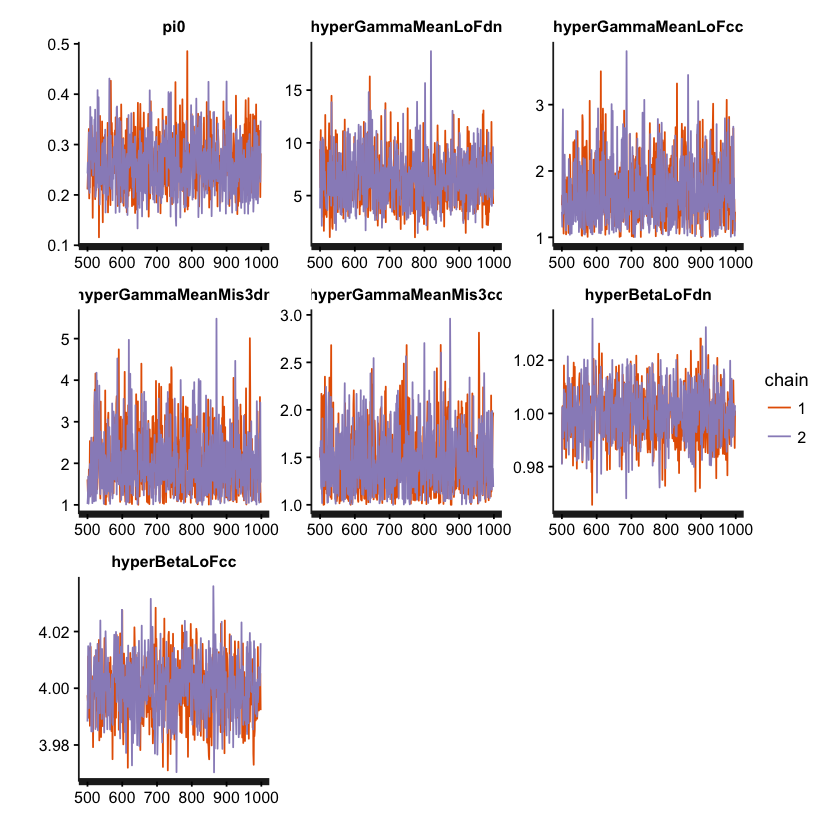

In [9]:
library("rstan")
dirFile = "/Users/hoang/Documents/SaveDataFromServer/RSTAN"
fileName <- "test_rstan_2016.Singleton.NoExac.nChain.constrainPio.4.nIteration10000.nThin.10.index.20reannotate_missense.RData"
i=1
load(paste(dirFile, "/", fileName[i], sep = ""))
print(testFitDenovoCC2)
print(stan_trace(testFitDenovoCC2))
cor(mixdataDenovoCC2$yCaseLoF, data$case_lof_Singleton_noexac)
cor(mixdataDenovoCC2$yCaseMis3, data$case_missense_Singleton_noexac)


In [10]:
y.case.lof <- data$case_lof_Singleton_noexac
y.control.lof <- data$control_lof_Singleton_noexac
y.case.mis3 <- data$case_missense_Singleton_noexac
y.control.mis3 <- data$control_missense_Singleton_noexac

yLoF <- data$dn_lof
mutLoF <- data$mut_lof

NN = length(y.case.lof)
yMis3 <- data$dn_missense
mutMis3 <- data$mut_missense


                
Ncase <- N$ca
Ncontrol <- N$cn
pH0 <- Ncase/(Ncase + Ncontrol)

BFccLoF <- bfcc(ycase = y.case.lof, ytotal = y.case.lof + y.control.lof, Ncase = N$ca, Ncontrol = N$cn,
             hyperGammaMeanCC = 1.68, hyperBetaCC = 4)

range(BFccLoF)
yTemp <- y.case.mis3 + y.control.mis3

BFccMis3 <- bfcc(ycase = y.case.mis3, ytotal = y.case.mis3 + y.control.mis3, Ncase = N$ca, Ncontrol = N$cn,
                hyperGammaMeanCC = 1.45, hyperBetaCC = 4)
range(BFccMis3)

source("TADA/TADA.R")

BFdnLoF <- bayes.factor.denovo(x = yLoF, N = N$dn, mu = mutLoF, gamma.mean = 6.44, beta = 1)
BFdnMis3 <- bayes.factor.denovo(x = yMis3, N = N$dn, mu = mutMis3, gamma.mean = 2.01, beta = 1)

BFall <- BFccMis3*BFccLoF*BFdnLoF*BFdnMis3



data$BF <- BFall
data <- data[order(-data$BF),]
pi0 <- 1 - 0.26
data$qvalue <- Bayesian.FDR(data$BF, pi0)$FDR

data1 <- (data[data$qvalue < 0.3, ])
dim(data1)
#data1



[1] 0.1378291 2.7445386

[1]  0.06204103 28.46032338

[1] 101  43

In [12]:
xNew2 <- (data[data$qvalue < 0.3, 1])
xNew2
write.table(data, "../data/FDR_scz2016_Singleon_noexac_pi026.txt", row.names = FALSE, quote = FALSE)      
length(intersect(xNew, xNew2))

[1] SYNGAP1   TAF13     ABLIM2    JAKMIP3   HSPA8     ZNF451    ABCC10   
  [8] SETD1A    LAMA4     WDR7      AUTS2     BRSK2     CCDC178   DMWD     
 [15] CUZD1     INTS6     ANKRD28   RARG      HUWE1     GPR161    CELF2    
 [22] BPTF      CCDC67    LMO7      PTPRR     DRC1      CDH23     TNFRSF13C
 [29] ESAM      GLIPR1L2  TAS1R3    BECN1     RNF38     RASSF5    GTPBP3   
 [36] SSBP3     NLRC5     HERC1     KDM5C     COG3      AKD1      UGT2B28  
 [43] CARD6     SEC31A    MIF       CACNA1E   HSP90AA1  ADCY2     ST3GAL6  
 [50] ZNF169    FILIP1    PRRC2A    DDHD2     KIF25     TLK1      PSPC1    
 [57] NOM1      CHERP     SLC13A5   PIGO      YTHDC1    COLGALT1  ZNF781   
 [64] NUDT19    ATG12     SEC31B    PHF7      ANAPC5    SELE      BLNK     
 [71] THBD      CD163     AGO4      ATP2B2    KPNA1     MSH2      HIST1H1E 
 [78] NR2E3     NUP54     ZMYND11   ALAS1     MED29     FLAD1     NISCH    
 [85] TLE6      NPHP4     CAPN10    PCSK2     ATG14     SMG5      GNPTAB   
 [92] ATAD5     CA10      B4GALNT1  KLHL25    RGS12     SEMA3C    MAN2B2   
 [99] RB1CC1    MAP3K11   ZEB1     
21376 Levels: A1BG A1BG-AS1 A1CF A2M A2M-AS1 A2ML1 A2MP1 A3GALT2 A4GALT ... ZZZ3

[1] 99

[1] 38


 0  1  2 
65 34  2 

[1] 26


    0     1     2 
18810    74     1 

,Gene,mut_lof,mut_missense,dn_damaging,dn_lof,control_damaging,case_damaging,control_lof,case_lof,mut_damaging,ellip.h,case_missense_maf001,control_missense_maf001,case_missense_noexac_maf001,control_missense_noexac_maf001,case_lof_maf001,control_lof_maf001,case_lof_noexac_maf001,control_lof_noexac_maf001,BF,qvalue
11601,MKI67,4.917779e-06,8.734509e-05,0,2,2,2,5,7,1.79116e-06,⋯,146,201,51,78,7,5,7,4,1.40157,0.5551227


Warning message:
In `[<-.factor`(`*tmp*`, ri, value = "⋮"): invalid factor level, NA generatedWarning message:
In `[<-.factor`(`*tmp*`, ri, value = "⋮"): invalid factor level, NA generated

,Gene,dn_lof,dn_missense,case_lof_Singleton_noexac,control_lof_Singleton_noexac,case_missense_Singleton_noexac,control_missense_Singleton_noexac
18144,SYNGAP1,1,0,0,0,13,3
18219,TAF13,2,0,1,0,1,0
117,ABLIM2,0,0,4,0,14,3
8626,JAKMIP3,0,0,1,0,13,2
8058,HSPA8,1,2,0,0,5,6
20988,ZNF451,0,0,0,0,16,4
62,ABCC10,0,0,0,1,18,5
16614,SETD1A,2,0,1,0,14,19
9329,LAMA4,0,1,0,0,22,11
20328,WDR7,0,0,0,0,19,7


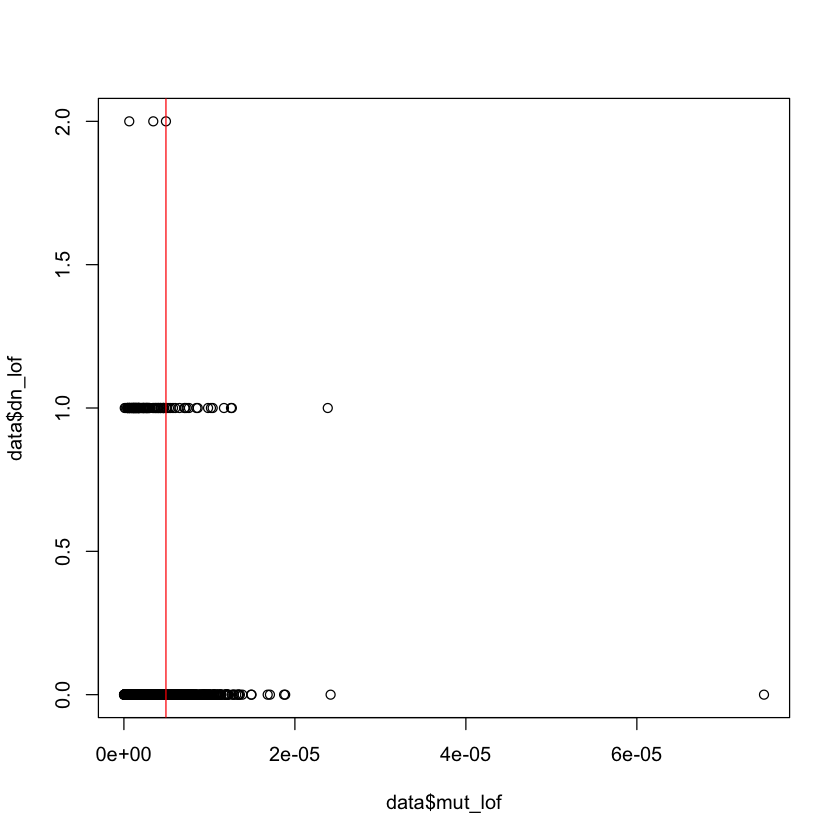

In [19]:
data2 <- data1[, c("Gene", "dn_lof", "dn_missense", 
                   "case_lof_Singleton_noexac", "control_lof_Singleton_noexac",
                  "case_missense_Singleton_noexac", "control_missense_Singleton_noexac")]
sum(data2$dn_lof)
table(data2$dn_lof)

sum(data2$dn_missense)

table(data[data$qvalue > 0.3, ]$dn_lof)

t1 <- data[(data$qvalue > 0.3) & (data$dn_lof ==2), ]
t1

plot(data$mut_lof, data$dn_lof)
abline(v = t1$mut_lof, col= 'red')

data2



## Test for damaging + LoF

In [26]:
data <- read.table("../data/scz_data_Feb_2016_including_noexac.txt", header =TRUE)


dim(data)
ntrio <- 617 #Menachem
ntrio <- ntrio + 14 #Girard
ntrio <- ntrio + 105 #Gulsuner
ntrio <- ntrio + 57 #McCarthy
ntrio <- ntrio + 231 #Xu

ncase = 4954
ncontrol <- 6239
N <- list(dn=ntrio, ca=ncase, cn= ncontrol)
dim(data)
#data <- data[data$mut_lof > 0, ]
t1 <- as.numeric(data$mut_lof)
t1 <- t1[t1 > 0]
data[data$mut_lof == 0, ]$mut_lof <- min(t1)
#data <- data[data$mut_missense >0, ]
t2 <- as.numeric(data$mut_missense)
t2 <- t2[t2 > 0]
data[data$mut_missense == 0, ]$mut_missense <- min(t2)
dim(data)

#data <- data[data$mut_missense >0, ]
t2 <- as.numeric(data$mut_damaging)
t2 <- t2[t2 > 0]
data[data$mut_damaging == 0, ]$mut_damaging <- min(t2)
dim(data)
#data <- data[data$mut_lof > 0, ]
#data <- data[data$mut_missense >0, ]
dim(data)

y.case.lof <- data$case_lof_maf001 #_Singleton #_noexac
y.control.lof <- data$control_lof_maf001 #_Singleton #_noexac
yLoF <- data$dn_lof
mutLoF <- data$mut_lof

#y.case.mis3 <- data$case_missense_maf001 #_Singleton #_noexac
#y.control.mis3 <- data$control_missense_maf001 #_Singleton #_noexac
y.case.mis3 <- data$case_damaging
y.control.mis3 <- data$control_damaging
#yMis3 <- data$dn_missense
#mutMis3 <- data$mut_missense
yMis3 <- data$dn_damaging
mutMis3 <- data$mut_damaging


Ncase <- N$ca
Ncontrol <- N$cn
pH0 <- Ncase/(Ncase + Ncontrol)

BFccLoF <- bfcc(ycase = y.case.lof, ytotal = y.case.lof + y.control.lof, Ncase = N$ca, Ncontrol = N$cn,
             hyperGammaMeanCC = 2.25, hyperBetaCC = 9)

range(BFccLoF)
yTemp <- y.case.mis3 + y.control.mis3

BFccMis3 <- bfcc(ycase = y.case.mis3, ytotal = y.case.mis3 + y.control.mis3, Ncase = N$ca, Ncontrol = N$cn,
                hyperGammaMeanCC = 1.63, hyperBetaCC = 9)
range(BFccMis3)

source("TADA/TADA.R")

BFdnLoF <- bayes.factor.denovo(x = yLoF, N = N$dn, mu = mutLoF, gamma.mean = 17.2, beta = 1)
BFdnMis3 <- bayes.factor.denovo(x = yMis3, N = N$dn, mu = mutMis3, gamma.mean = 3.78, beta = 1)

BFall <- BFccMis3*BFccLoF*BFdnLoF*BFdnMis3



data$BF <- BFall
data <- data[order(-data$BF),]
pi0 <- 1 - 0.07
data$qvalue <- Bayesian.FDR(data$BF, pi0)$FDR

data1 <- (data[data$qvalue < 0.3, ])
dim(data1)


[1] 21376    51

[1] 21376    51

[1] 21376    51

[1] 21376    51

[1] 21376    51

[1] 3.125552e-03 1.821262e+02

[1]  0.03107334 30.78228181

[1] 58 53

In [27]:
write.table(data, "../data/FDR_scz2016_maf001_lof_damaging_pi006.txt", row.names = FALSE, quote = FALSE)      

xemData <- data[, c("Gene", "dn_lof", "dn_damaging",
                    "case_lof_maf001", "control_lof_maf001",
                    "case_damaging", "control_damaging", "qvalue"), ]
head(xemData, 50)

,Gene,dn_lof,dn_damaging,case_lof_maf001,control_lof_maf001,case_damaging,control_damaging,qvalue
16614,SETD1A,2,0,2,0,4,5,0.03334709
18219,TAF13,2,0,1,0,0,1,0.03631088
550,ALDH1L2,0,1,21,6,8,13,0.04496817
11523,MIF,1,0,6,1,5,3,0.05478142
609,ALS2CL,1,0,12,5,4,5,0.06855796
11601,MKI67,2,0,10,11,2,2,0.07812217
20664,ZDHHC5,1,0,1,1,9,2,0.08656092
16200,RTTN,1,0,6,6,19,10,0.09540674
12315,NCKIPSD,1,0,5,1,0,0,0.1046839
8838,KDM5C,1,0,2,0,3,0,0.1131943


## Use data from Broad 

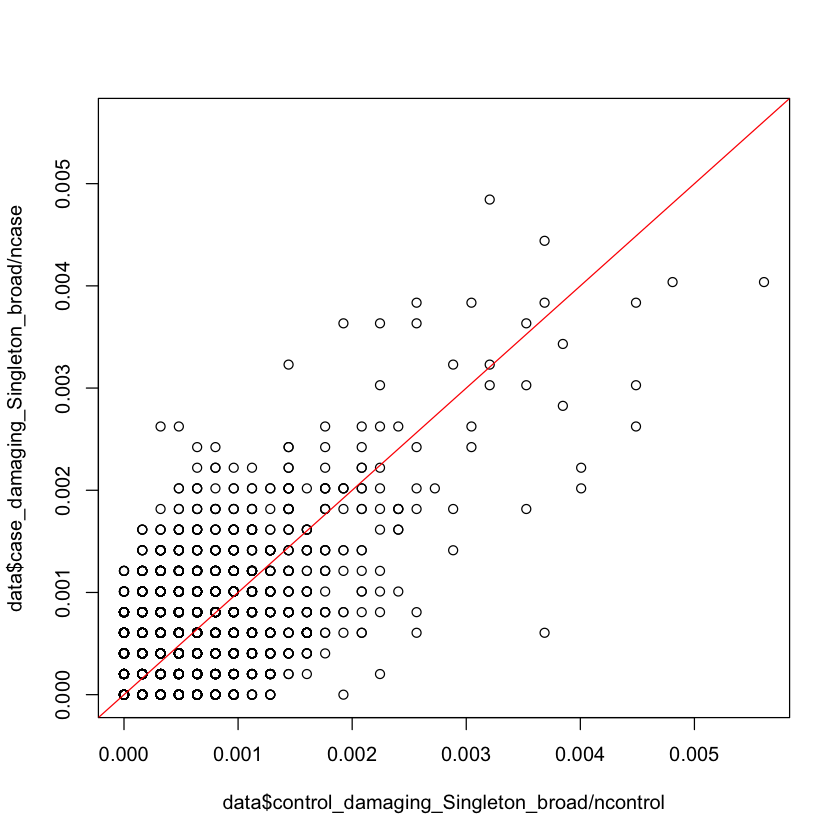

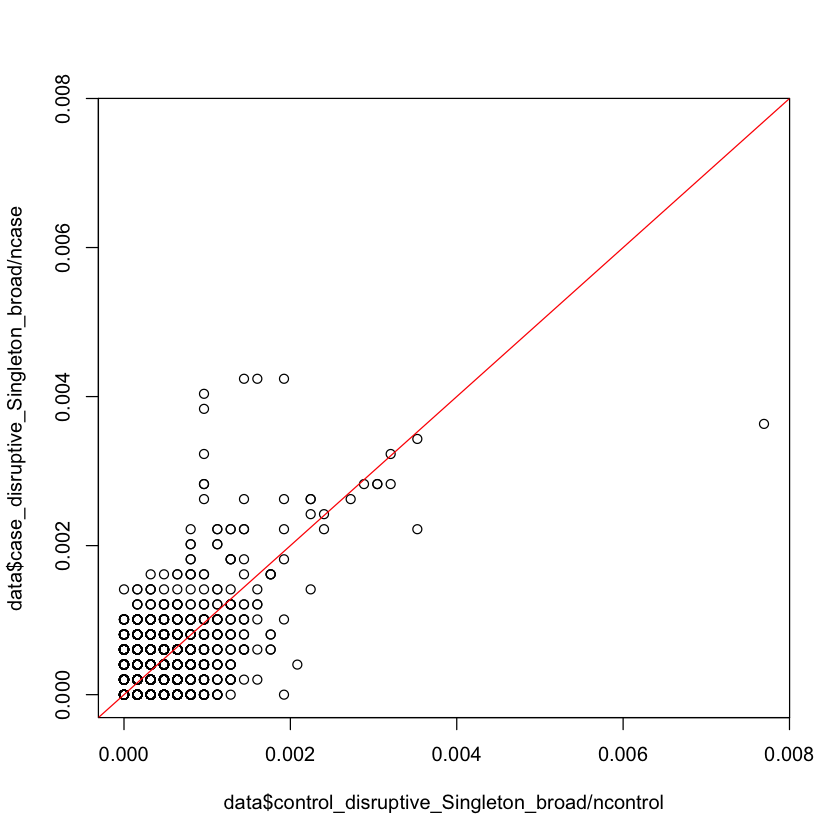

In [42]:
bCase <- data$case_damaging_Singleton_broad/ncase
bControl <- data$control_damaging_Singleton_broad/ncontrol
rangeXY <- range(c(bCase, bControl))
plot(data$control_damaging_Singleton_broad/ncontrol, data$case_damaging_Singleton_broad/ncase, xlim = rangeXY, ylim = rangeXY )
abline(a = 0, b= 1, col = 'red')

bCase <- data$case_disruptive_Singleton_broad/ncase
bControl <- data$control_disruptive_Singleton_broad/ncontrol
rangeXY <- range(c(bCase, bControl))
plot(data$control_disruptive_Singleton_broad/ncontrol, data$case_disruptive_Singleton_broad/ncase, xlim = rangeXY, ylim = rangeXY )
abline(a = 0, b= 1, col = 'red')


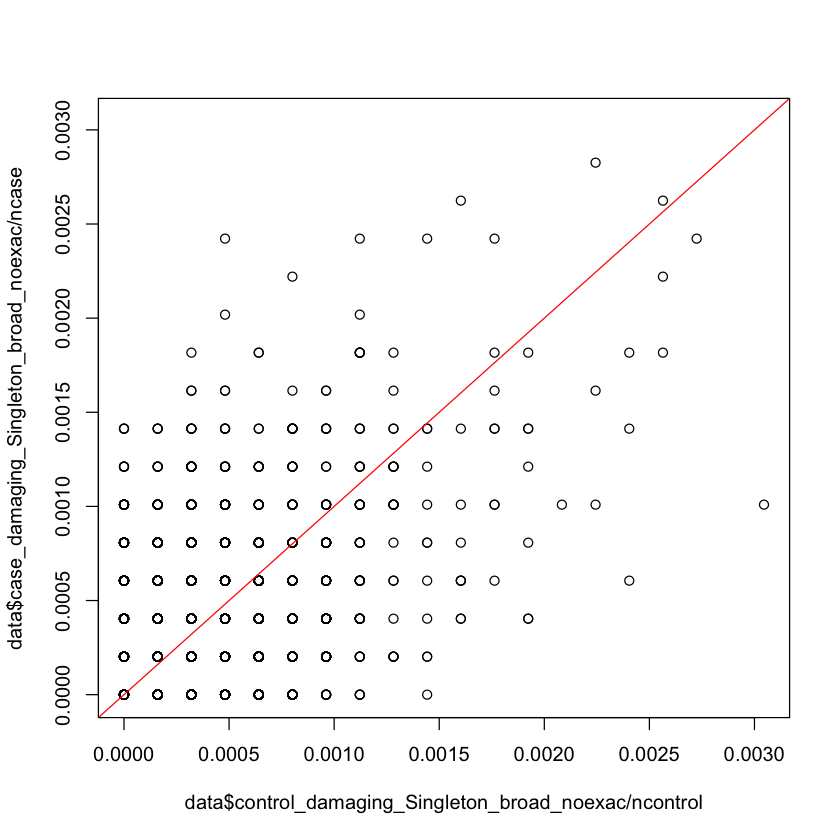

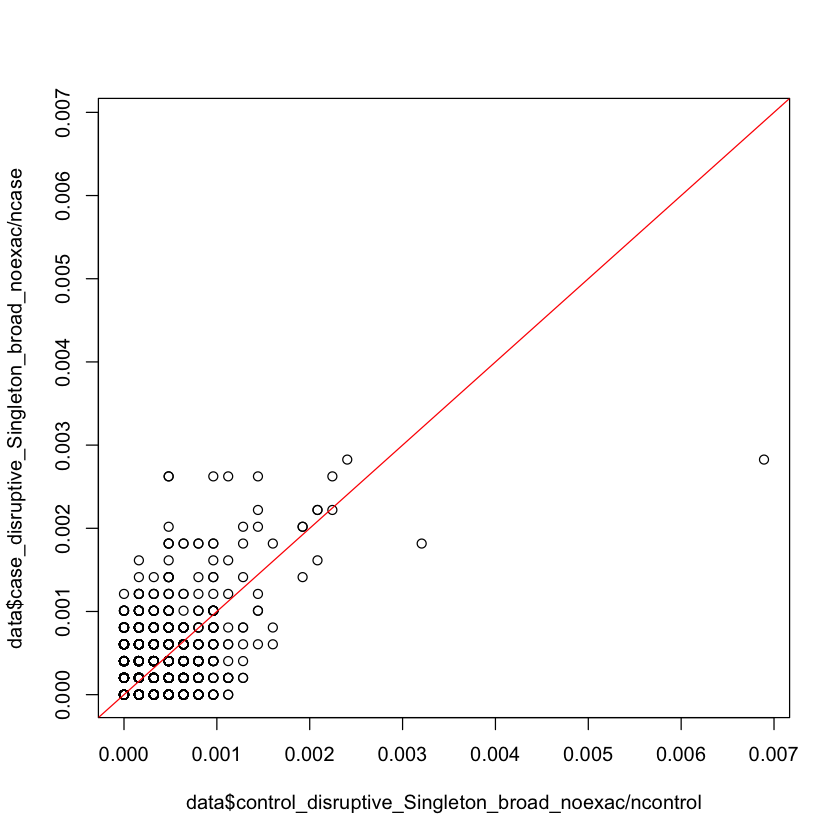

In [43]:
bCase <- data$case_damaging_Singleton_broad_noexac/ncase
bControl <- data$control_damaging_Singleton_broad_noexac/ncontrol
rangeXY <- range(c(bCase, bControl))
plot(data$control_damaging_Singleton_broad_noexac/ncontrol, 
     data$case_damaging_Singleton_broad_noexac/ncase, 
     xlim = rangeXY, ylim = rangeXY )
abline(a = 0, b= 1, col = 'red')

bCase <- data$case_disruptive_Singleton_broad_noexac/ncase
bControl <- data$control_disruptive_Singleton_broad_noexac/ncontrol
rangeXY <- range(c(bCase, bControl))
plot(data$control_disruptive_Singleton_broad_noexac/ncontrol, 
     data$case_disruptive_Singleton_broad_noexac/ncase, xlim = rangeXY, ylim = rangeXY )
abline(a = 0, b= 1, col = 'red')


In [36]:
dirFile = "/Users/hoang/Documents/SaveDataFromServer/RSTAN/"
fileN <- dir(dirFile, "Broad.noExac.RData")
fileN


[1] "test_rstan_2016.maf001.NoExac.nChain.NOconstrainPio.1.nIteration1000.nThin.1.index.4221reannotate_missensebeta9.notMissenseCC.addDamaging.SingletonBroad.noExac.RData"  
[2] "test_rstan_2016.maf001.NoExac.nChain.NOconstrainPio.1.nIteration10000.nThin.10.index.4221reannotate_missensebeta9.notMissenseCC.addDamaging.SingletonBroad.noExac.RData"
[3] "test_rstan_2016.maf001.NoExac.nChain.NOconstrainPio.1.nIteration20000.nThin.20.index.4221reannotate_missensebeta9.notMissenseCC.addDamaging.SingletonBroad.noExac.RData"
[4] "test_rstan_2016.maf001.NoExac.nChain.NOconstrainPio.1.nIteration250.nThin.1.index.4221reannotate_missensebeta9.notMissenseCC.addDamaging.SingletonBroad.noExac.RData"   
[5] "test_rstan_2016.maf001.NoExac.nChain.NOconstrainPio.1.nIteration500.nThin.1.index.4221reannotate_missensebeta9.notMissenseCC.addDamaging.SingletonBroad.noExac.RData"

Inference for Stan model: 08e23b88ef618b89ebecc0bcd95456f2.
1 chains, each with iter=20000; warmup=10000; thin=20; 
post-warmup draws per chain=500, total post-warmup draws=500.

                          mean se_mean   sd      2.5%       25%       50%
pi0                       0.04    0.00 0.02      0.02      0.03      0.04
hyperGammaMeanLoFdn      19.55    0.26 5.74      9.67     15.14     19.24
hyperGammaMeanLoFcc       3.20    0.06 1.14      2.05      2.42      2.93
hyperGammaMeanMis3dn      4.08    0.09 1.84      2.11      2.76      3.59
hyperGammaMeanMis3cc      2.46    0.02 0.43      2.02      2.13      2.35
hyperBetaLoFdn            1.00    0.00 0.01      0.98      0.99      1.00
hyperBetaLoFcc            9.00    0.00 0.01      8.98      8.99      9.00
lp__                 -21550.21    0.13 2.83 -21556.76 -21551.95 -21549.82
                           75%     97.5% n_eff Rhat
pi0                       0.05      0.08   500 1.00
hyperGammaMeanLoFdn      23.31     31.87   500 1.00

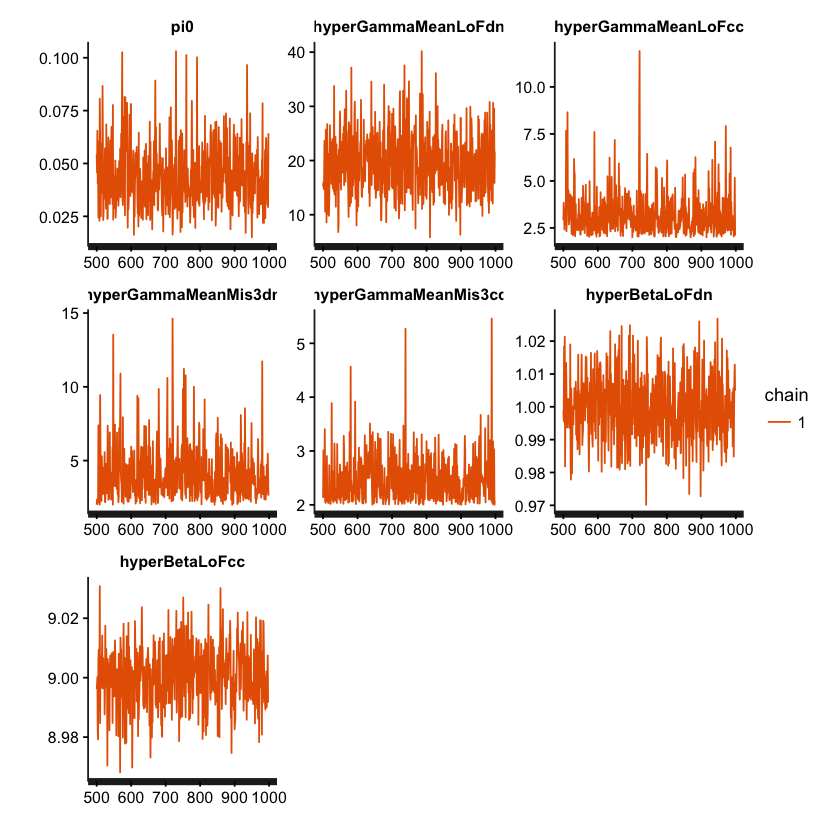

In [37]:
ii=3
load(paste(dirFile, fileN[ii], sep = ""))
    print(testFitDenovoCC2)
    print(fileN[ii])
    print(stan_trace(testFitDenovoCC2))


In [38]:
data <- read.table("../data/scz_data_Feb_2016_including_noexac.txt", header =TRUE)


dim(data)
ntrio <- 617 #Menachem
ntrio <- ntrio + 14 #Girard
ntrio <- ntrio + 105 #Gulsuner
ntrio <- ntrio + 57 #McCarthy
ntrio <- ntrio + 231 #Xu

ncase = 4954
ncontrol <- 6239
N <- list(dn=ntrio, ca=ncase, cn= ncontrol)
dim(data)
#data <- data[data$mut_lof > 0, ]
t1 <- as.numeric(data$mut_lof)
t1 <- t1[t1 > 0]
data[data$mut_lof == 0, ]$mut_lof <- min(t1)
#data <- data[data$mut_missense >0, ]
t2 <- as.numeric(data$mut_missense)
t2 <- t2[t2 > 0]
data[data$mut_missense == 0, ]$mut_missense <- min(t2)
dim(data)

#data <- data[data$mut_missense >0, ]
t2 <- as.numeric(data$mut_damaging)
t2 <- t2[t2 > 0]
data[data$mut_damaging == 0, ]$mut_damaging <- min(t2)
dim(data)
#data <- data[data$mut_lof > 0, ]
#data <- data[data$mut_missense >0, ]
dim(data)


y.case.lof <- data$case_disruptive_Singleton_broad_noexac #case_lof_maf001 #_Singleton #_noexac
y.control.lof <- data$control_disruptive_Singleton_broad_noexac #control_lof_maf001 #_Singleton #_noexac
yLoF <- data$dn_lof
mutLoF <- data$mut_lof

#y.case.mis3 <- data$case_missense_maf001 #_Singleton #_noexac
#y.control.mis3 <- data$control_missense_maf001 #_Singleton #_noexac
y.case.mis3 <- data$case_damaging_Singleton_broad_noexac #case_damaging
y.control.mis3 <- data$control_damaging_Singleton_broad_noexac #control_damaging
#yMis3 <- data$dn_missense
#mutMis3 <- data$mut_missense
yMis3 <- data$dn_damaging
mutMis3 <- data$mut_damaging


Ncase <- N$ca
Ncontrol <- N$cn
pH0 <- Ncase/(Ncase + Ncontrol)

BFccLoF <- bfcc(ycase = y.case.lof, ytotal = y.case.lof + y.control.lof, Ncase = N$ca, Ncontrol = N$cn,
             hyperGammaMeanCC = 3.2, hyperBetaCC = 9)

range(BFccLoF)
yTemp <- y.case.mis3 + y.control.mis3

BFccMis3 <- bfcc(ycase = y.case.mis3, ytotal = y.case.mis3 + y.control.mis3, Ncase = N$ca, Ncontrol = N$cn,
                hyperGammaMeanCC = 2.46, hyperBetaCC = 9)
range(BFccMis3)

source("TADA/TADA.R")

BFdnLoF <- bayes.factor.denovo(x = yLoF, N = N$dn, mu = mutLoF, gamma.mean = 19.55, beta = 1)
BFdnMis3 <- bayes.factor.denovo(x = yMis3, N = N$dn, mu = mutMis3, gamma.mean = 4.08, beta = 1)

BFall <- BFccMis3*BFccLoF*BFdnLoF*BFdnMis3



data$BF <- BFall
data <- data[order(-data$BF),]
pi0 <- 1 - 0.04
data$qvalue <- Bayesian.FDR(data$BF, pi0)$FDR

data1 <- (data[data$qvalue < 0.3, ])
dim(data1)


[1] 21376    51

[1] 21376    51

[1] 21376    51

[1] 21376    51

[1] 21376    51

[1] 4.967174e-06 6.688161e+01

[1]  0.006354257 27.171312303

[1] 20 53

In [39]:
write.table(data, "../data/FDR_scz2016_damaging_disruptive_Singleton_broad_pi004.txt", row.names = FALSE, quote = FALSE)      

xemData <- data[, c("Gene", "dn_lof", "dn_damaging",
                    "case_disruptive_Singleton_broad_noexac", "control_disruptive_Singleton_broad_noexac",
                    "case_damaging_Singleton_broad_noexac", "control_damaging_Singleton_broad_noexac",
                    "qvalue"), ]
head(xemData, 70)

Warning message:
In `[<-.factor`(`*tmp*`, ri, value = "⋮"): invalid factor level, NA generatedWarning message:
In `[<-.factor`(`*tmp*`, ri, value = "⋮"): invalid factor level, NA generated

,Gene,dn_lof,dn_damaging,case_disruptive_Singleton_broad_noexac,control_disruptive_Singleton_broad_noexac,case_damaging_Singleton_broad_noexac,control_damaging_Singleton_broad_noexac,qvalue
18219,TAF13,2,0,1,0,0,0,0.0368584133440227
16614,SETD1A,2,0,1,0,2,2,0.0445706965182791
15471,RB1CC1,1,0,3,0,2,0,0.0755634910075726
8838,KDM5C,1,0,2,0,3,0,0.0958373440507766
10744,LPHN2,1,1,0,0,4,2,0.112440109507778
14922,PRRC2A,1,0,1,0,5,1,0.126140118030064
11523,MIF,1,0,0,0,3,0,0.147337930015356
15422,RARG,1,0,0,0,3,0,0.165451297068323
8058,HSPA8,1,0,1,0,1,0,0.187279683588183
19153,TNRC18,1,0,2,0,0,0,0.205086576953466


## Combine damaging + LoF analysed by Broad = disruptive

In [28]:
y.case.lof <- data$case_disruptive_Singleton_broad
y.control.lof <- data$control_disruptive_Singleton_broad

yLoF <- data$dn_lof
mutLoF <- data$mut_lof

yMis3 <- data$dn_damaging
mutMis3 <- data$mut_damaging

mutLoF <- mutLoF + mutMis3
yLoF <- yLoF + yMis3

Ncase <- N$ca
Ncontrol <- N$cn
pH0 <- Ncase/(Ncase + Ncontrol)

BFccLoF <- bfcc(ycase = y.case.lof, ytotal = y.case.lof + y.control.lof, Ncase = N$ca, Ncontrol = N$cn,
             hyperGammaMeanCC = 2.67, hyperBetaCC = 4)


source("TADA/TADA.R")

BFdnLoF <- bayes.factor.denovo(x = yLoF, N = N$dn, mu = mutLoF, gamma.mean = 8.3, beta = 1)

BFall <- BFccLoF*BFdnLoF


data$BF <- BFall
data <- data[order(-data$BF),]
pi0 <- 1 - 0.05
data$qvalue <- Bayesian.FDR(data$BF, pi0)$FDR

data1 <- (data[data$qvalue < 0.3, ])
dim(data1)



[1] 12 53

In [29]:
write.table(data, "../data/FDR_scz2016_disruptive_Singleton_broad_pi005.txt", row.names = FALSE, quote = FALSE)      

xemData <- data[, c("Gene", "dn_lof", "dn_damaging",
                    "case_disruptive_Singleton_broad", "control_disruptive_Singleton_broad",
                    "qvalue"), ]
head(xemData, 50)

,Gene,dn_lof,dn_damaging,case_disruptive_Singleton_broad,control_disruptive_Singleton_broad,qvalue
13735,PCDHA4,0,0,20,6,0.1007782
16614,SETD1A,2,0,2,0,0.1110846
18219,TAF13,2,0,1,0,0.1220616
13736,PCDHA5,0,0,19,6,0.1292159
20478,XPO7,0,1,5,0,0.1527017
10744,LPHN2,1,1,1,1,0.1731885
13734,PCDHA3,0,0,21,9,0.1925542
4942,DPYD,1,1,0,1,0.2097564
13737,PCDHA6,0,0,16,6,0.2312751
15471,RB1CC1,1,0,3,0,0.2509316


## Compare this with reduced model on Autism 2014

In [14]:
data <- read.table("TADA/data/ASC_2231trios_1333trans_1601cases_5397controls.csv", header = TRUE, sep = ",")
#data <- read.table("/Users/hoang/Documents/GitHub/NewTestR/TestR/HBproject/extTADA/scripts/dataFromTADApaper2013.txt",header = TRUE)
ntrio <- 2231  # number of trios
ncase <- 1601  # number of cases
nctrl <- 5397  # number of controls
ntrans <- 1333 # number of subjects with transmission data

N <- list(dn=ntrio, ca=ntrans+ncase, cn=ntrans+nctrl)
#data <- read.table("TADA/data/ASC_2231trios_1333trans_1601cases_5397controls.csv", header = TRUE, sep = ",")
counts <- as.array(cbind(data$dn.LoF, data$case.LoF+data$trans.LoF, data$ctrl.LoF+data$ntrans.LoF,
                         data$dn.mis3, data$case.mis3+data$trans.mis3,
                         data$ctrl.mis3+data$ntrans.mis3))
mu.frac <- c(0.074, 0.32)
gamma.mean.dn <- c(20, 4.7)
beta.dn <- c(1,1)
gamma.mean.CC <- c(2.3, 1.00)
beta.CC <- c(4.0, 1000)
rho1 <- c(0.1, 0.5)
nu1 <- c(200, 100)
rho0 <- c(0.1, 0.5)
nu0 <- c(200, 100)
hyperpar <- as.array(rbind(gamma.mean.dn, beta.dn, gamma.mean.CC, beta.CC, rho1, nu1, rho0, nu0))
l <- 100
pi0 <- 0.94 # the fraction of non-risk genes

dim(data)



[1] 18735    12

In [17]:
y.case.lof <- counts[, 2]
y.control.lof <- counts[, 3]
#y.case.mis3 <- data$case_missense_Singleton_noexac
#y.control.mis3 <- data$control_missense_Singleton_noexac

yLoF <- data$dn.LoF
mutLoF <- data$mut.rate*mu.frac[1]
length(mutLoF)

NN = length(y.case.lof)
yMis3 <- data$dn.mis3
mutMis3 <- data$mut.rate*mu.frac[2]
length(mutMis3)

                
Ncase <- N$ca
Ncontrol <- N$cn
pH0 <- Ncase/(Ncase + Ncontrol)

BFccLoF <- bfcc(ycase = y.case.lof, ytotal = y.case.lof + y.control.lof, Ncase = N$ca, Ncontrol = N$cn,
             hyperGammaMeanCC = 2.3, hyperBetaCC = 4.01)

range(BFccLoF)
#yTemp <- y.case.mis3 + y.control.mis3

#BFccMis3 <- bfcc(ycase = y.case.mis3, ytotal = y.case.mis3 + y.control.mis3, Ncase = N$ca, Ncontrol = N$cn,
 #               hyperGammaMeanCC = 1.45, hyperBetaCC = 4.05)
#range(BFccMis3)

source("TADA/TADA.R")

BFdnLoF <- bayes.factor.denovo(x = yLoF, N = N$dn, mu = mutLoF, gamma.mean = 20, beta = 1)
range(BFdnLoF)
BFdnMis3 <- bayes.factor.denovo(x = yMis3, N = N$dn, mu = mutMis3, gamma.mean = 4.7, beta = 1)
range(BFdnMis3)
BFall <- BFccLoF*BFdnLoF*BFdnMis3



data$BF <- BFall
data <- data[order(-data$BF),]
pi0 <- 1 - 0.06
data$qvalue <- Bayesian.FDR(data$BF, pi0)$FDR

data1 <- (data[data$qvalue < 0.3, ])
dim(data1)
#data1

                

[1] 18735

[1] 18735

[1]   0.02715979 181.16614827

[1] 2.176949e-02 7.470313e+07

[1]    0.1631823 5044.4637610

[1] 110  14

In [28]:
data1 <- read.table("TADA/data/TADA_results.csv", header = TRUE, sep = ",")

In [29]:
dataA <- merge(data, data1, by.x = "Gene", by.y = "Gene")

In [30]:
head(dataA)

,Gene,mut.rate.x,dn.LoF.x,case.LoF.x,ctrl.LoF.x,trans.LoF.x,ntrans.LoF.x,dn.mis3.x,case.mis3.x,ctrl.mis3.x,ellip.h,trans.LoF.y,ntrans.LoF.y,dn.mis3.y,case.mis3.y,ctrl.mis3.y,trans.mis3.y,ntrans.mis3.y,BF.y,pval.TADA,qvalue.y
1,A1BG,2.355e-05,0,0,1,0,0,0,0,4,⋯,0,0,0,0,4,7,3,0.5495361,0.3954614,0.9132353
2,A1CF,2.174e-05,0,1,2,1,1,0,0,7,⋯,1,1,0,0,7,3,7,0.7549958,0.2448433,0.884154
3,A2LD1,6.09e-06,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0.5082456,0.4815837,0.9229287
4,A2M,5.64e-05,0,1,5,1,0,0,4,22,⋯,1,0,0,4,22,6,6,0.2967444,0.8806266,0.9456775
5,A2ML1,5.7e-05,0,3,16,2,6,0,5,30,⋯,2,6,0,5,30,6,10,0.05155223,0.9972805,0.9506706
6,A4GALT,2.415e-05,0,0,2,1,0,0,1,5,⋯,1,0,0,1,5,2,1,0.6311046,0.3222994,0.9018963


[1] 0.9132353 0.8841540 0.9229287 0.9456775 0.9506706 0.9018963

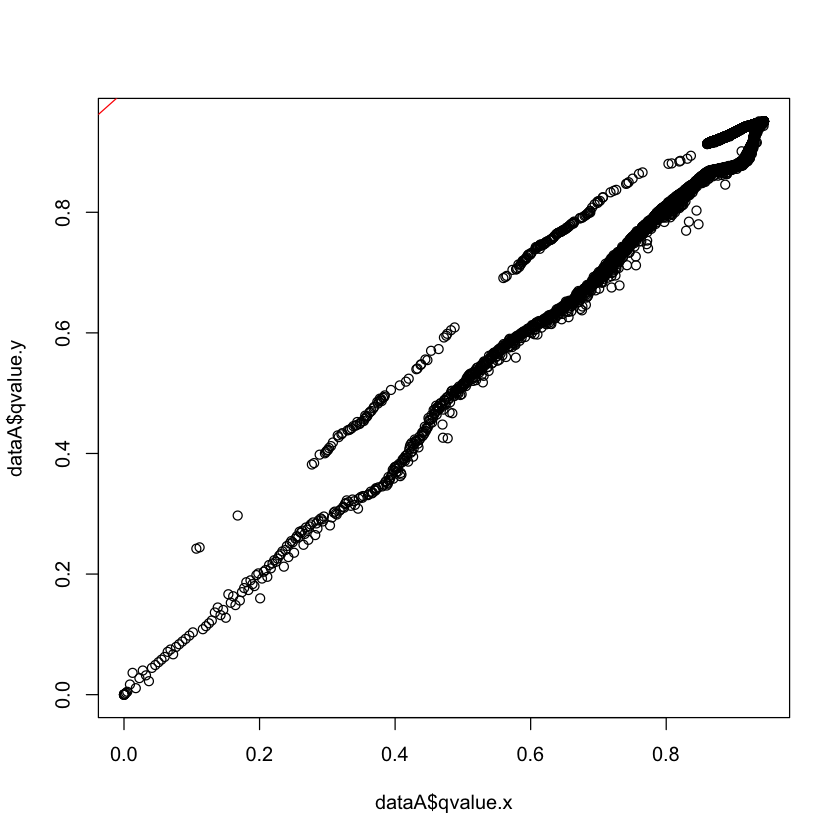

In [34]:
head(dataA$qvalue.y)
plot(dataA$qvalue.x, dataA$qvalue.y)
abline(a = 1, b = 1, col = 'red')

In [32]:
colnames(dataA)

[1] "Gene"          "mut.rate.x"    "dn.LoF.x"      "case.LoF.x"   
 [5] "ctrl.LoF.x"    "trans.LoF.x"   "ntrans.LoF.x"  "dn.mis3.x"    
 [9] "case.mis3.x"   "ctrl.mis3.x"   "trans.mis3.x"  "ntrans.mis3.x"
[13] "qvalue.x"      "BF.x"          "mut.rate.y"    "dn.LoF.y"     
[17] "case.LoF.y"    "ctrl.LoF.y"    "trans.LoF.y"   "ntrans.LoF.y" 
[21] "dn.mis3.y"     "case.mis3.y"   "ctrl.mis3.y"   "trans.mis3.y" 
[25] "ntrans.mis3.y" "BF.y"          "pval.TADA"     "qvalue.y"

In [46]:
dataA1 <- dataA[(dataA$qvalue.x < 0.3) & (dataA$qvalue.y < 0.3), ]
dim(dataA1)
dim(dataA[(dataA$qvalue.y < 0.1), ])
dim(dataA[(dataA$qvalue.x < 0.1), ])

[1] 104  28

[1] 33 28

[1] 33 28

In [44]:
head(cbind(dataA$BF.x, dataA$BF.y))
range(round(dataA$BF.x, 1))
range(round(dataA$BF.y, 1))

0.5483298,0.5495361
0.7442067,0.7549958
0.9158244,0.5082456
0.2863641,0.2967444
0.03558046,0.05155223
0.6277112,0.6311046


[1]          0 1622934027

[1]          0 1596280319

In [5]:
source("TADA/TADA.R")
data <- read.table("../data/scz_data_Feb_2016_including_noexac.txt", header = TRUE)
dim(data)
ntrio <- 617 #Menachem  Yes
ntrio <- ntrio + 14 #Girard Yes
ntrio <- ntrio + 105 #Gulsuner Yes
ntrio <- ntrio + 57 #McCarthy Yes
ntrio <- ntrio + 231 #Xu Yes

ntrio
ncase = 4954
ncontrol <- 6239
N <- list(dn=ntrio, ca=ncase, cn= ncontrol)

dim(data)
#data <- data[data$mut_lof > 0, ]
t1 <- as.numeric(data$mut_lof)
t1 <- t1[t1 > 0]
data[data$mut_lof == 0, ]$mut_lof <- min(t1)
#data <- data[data$mut_missense >0, ]
t2 <- as.numeric(data$mut_missense)
t2 <- t2[t2 > 0]
data[data$mut_missense == 0, ]$mut_missense <- min(t2)
dim(data)


y.case.lof <- data$case_lof_maf001
y.control.lof <- data$control_lof_maf001
y.case.mis3 <- data$case_missense_maf001
y.control.mis3 <- data$control_missense_maf001

yLoF <- data$dn_lof
mutLoF <- data$mut_lof

NN = length(y.case.lof)
yMis3 <- data$dn_missense
mutMis3 <- data$mut_missense


                
Ncase <- N$ca
Ncontrol <- N$cn
pH0 <- Ncase/(Ncase + Ncontrol)


                
Ncase <- N$ca
Ncontrol <- N$cn
pH0 <- Ncase/(Ncase + Ncontrol)


BFccLoF <- bfcc(ycase = y.case.lof, ytotal = y.case.lof + y.control.lof, Ncase = N$ca, Ncontrol = N$cn,
             hyperGammaMeanCC = 2.52, hyperBetaCC = 9)

range(BFccLoF)
#yTemp <- y.case.mis3 + y.control.mis3

#BFccMis3 <- bfcc(ycase = y.case.mis3, ytotal = y.case.mis3 + y.control.mis3, Ncase = N$ca, Ncontrol = N$cn,
 #               hyperGammaMeanCC = 1.45, hyperBetaCC = 4.05)
#range(BFccMis3)

source("TADA/TADA.R")

BFdnLoF <- bayes.factor.denovo(x = yLoF, N = N$dn, mu = mutLoF, gamma.mean = 26, beta = 1)
range(BFdnLoF)
BFdnMis3 <- bayes.factor.denovo(x = yMis3, N = N$dn, mu = mutMis3, gamma.mean = 3.42, beta = 1)
range(BFdnMis3)
BFall <- BFccLoF*BFdnLoF*BFdnMis3



data$BF <- BFall
data <- data[order(-data$BF),]
pi0 <- 1 - 0.05
data$qvalue <- Bayesian.FDR(data$BF, pi0)$FDR

data1 <- (data[data$qvalue < 0.3, ])
dim(data1)
#data1

                

[1] 21376    51

[1] 1024

[1] 21376    51

[1] 21376    51

[1] 6.122789e-04 2.482357e+02

[1]   0.02855893 678.17876016

[1]  0.1894224 58.2665695

[1] 58 53

In [6]:
xNew <- (data[data$qvalue < 0.3, 1])
xNew
write.table(data, "../data/FDR_tempWithSmallPi_scz2016_Singleon_noexac.txt", row.names = FALSE, quote = FALSE)

[1] TAF13     SETD1A    ALDH1L2   HSPA8     DPYD      ALS2CL    MIF      
 [8] MKI67     NCKIPSD   LNX1      NLRC5     PIK3C2B   PHF7      SSBP3    
[15] PSPC1     NIPAL3    UFL1      RB1CC1    POGZ      KLHL17    AKD1     
[22] LPHN2     HIST1H1E  KIAA1109  SLC35B2   TCP11L2   MYH9      STAC2    
[29] BRPF1     EPHA2     ART5      SEC31A    ITFG3     KDM5C     EPYC     
[36] PLEKHH2   HSP90AA1  BLNK      ZMYND11   XPR1      TTPA      SHANK1   
[43] YTHDC1    DLG2      AUTS2     TRH       TNRC18    ATG12     NIP7     
[50] PRDX6     ICAM1     DARC      TNFRSF13C FLAD1     NAP1L2    SERPINI1 
[57] ESAM      BTNL2    
21376 Levels: A1BG A1BG-AS1 A1CF A2M A2M-AS1 A2ML1 A2MP1 A3GALT2 A4GALT ... ZZZ3

In [7]:
head(xNew)

[1] TAF13   SETD1A  ALDH1L2 HSPA8   DPYD    ALS2CL 
21376 Levels: A1BG A1BG-AS1 A1CF A2M A2M-AS1 A2ML1 A2MP1 A3GALT2 A4GALT ... ZZZ3

In [8]:
getwd()

[1] "/Users/hoang/Documents/GitHub/NewTestR/TestR/HBproject/extTADA/scripts"